In [1]:
import pathlib
import pandas as pd
import matplotlib.pyplot as plt
import geopandas
import numpy as np
import plotly.express as px

In [2]:
fname='/dat1/gmanuch/DataScienceOceanography/MGG/earthquakes.parquet';
df = pd.read_parquet(pathlib.Path(fname))
df = df.set_index(df.time)

gdf = geopandas.GeoDataFrame(df, geometry=geopandas.points_from_xy(df.longitude, df.latitude),crs=4326)
gdf.keys()

Index(['depth', 'depthError', 'dmin', 'gap', 'horizontalError', 'id',
       'latitude', 'locationSource', 'longitude', 'mag', 'magError', 'magNst',
       'magSource', 'magType', 'net', 'nst', 'place', 'rms', 'status', 'time',
       'type', 'updated', 'geometry'],
      dtype='object')

In [3]:
gdf.drop(columns='time')[gdf.mag>6].explore(column='mag') # drop the time axis and explore high-magnitude events only; geopandas makes nice maps

In [4]:
df['year'] = pd.DatetimeIndex(df['time']).year # add year as a category to group by
df['marker_size'] = np.fix(np.exp(df['mag'])) # add marker size as exp(mag)

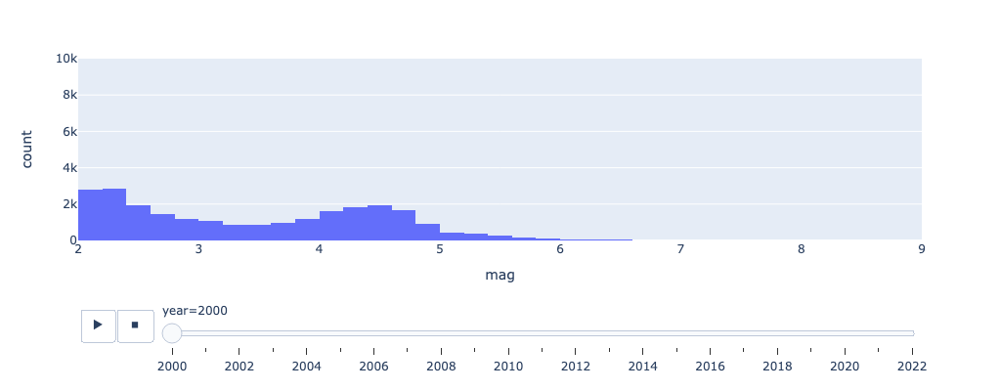

In [5]:
px.histogram(df[df.mag>2], #specify what dataframe to use
             x="mag",  #specify the variable for the histogram 
             animation_frame="year", #this is the parameter controlling the animation
             nbins=50, #number of bins for the histogram
             range_x=[2,9], #x and y ranges for the axis such that the axis don't wobble around
             range_y=[0,10e3], 
             height=400, #dimensions of the figure
             width=600)

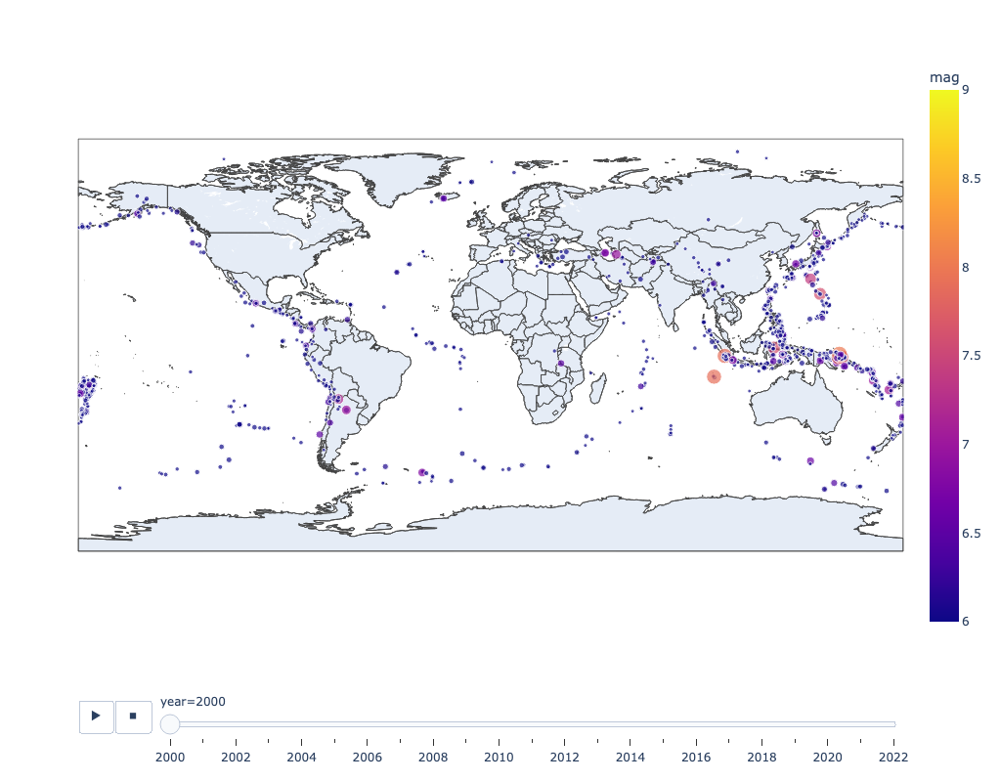

In [6]:
fig = px.scatter_geo(df[df.mag>5],
                     lat='latitude',lon='longitude', 
                     size='marker_size', color='mag',
                     hover_name='place', hover_data=['mag','depth','latitude','longitude', 'time'], 
                     range_color=(6,9),
                     height=800, width=1400,
                     animation_frame="year")
fig.update_geos(resolution=50, showcountries=True)
fig.show()
#fig.write_html("EarthquakesYears.html")

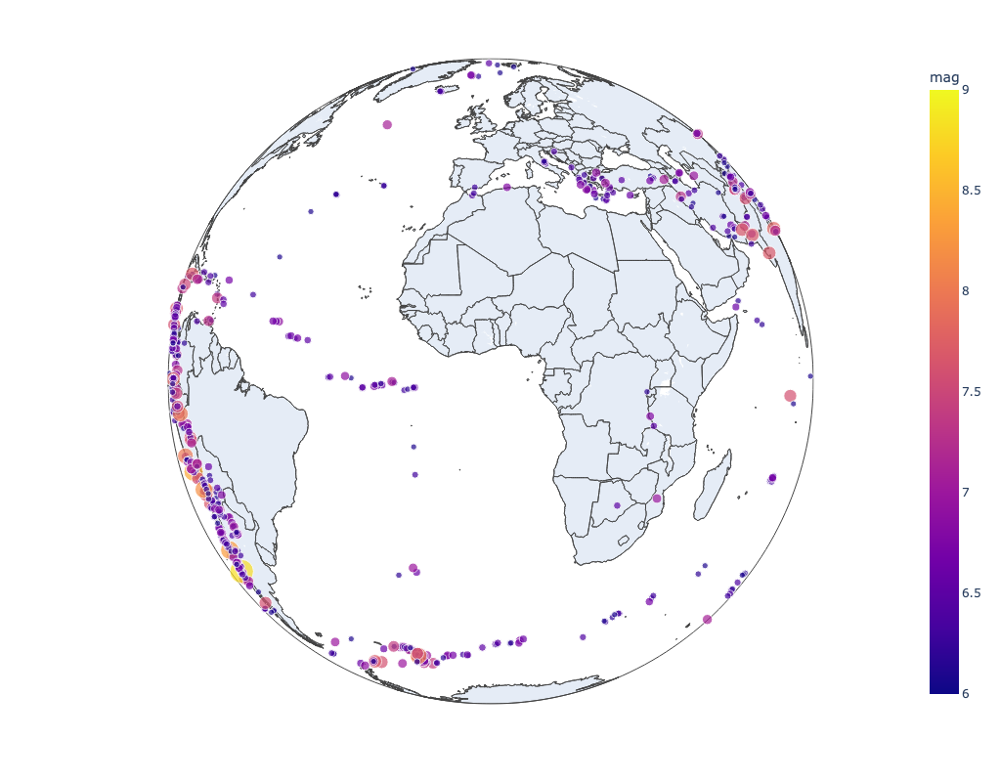

In [7]:
fig = px.scatter_geo(df[df.mag>6],
                     lat='latitude',lon='longitude', 
                     size='marker_size', color='mag',
                     hover_name='place', hover_data=['mag','depth','latitude','longitude', 'time'], 
                     range_color=(6,9),
                     height=800, width=1400)
fig.update_geos(resolution=50, showcountries=True, showlakes=True,projection_type='orthographic')
fig.show()
#fig.write_html("EarthquakesMag6+.html")